#**Transductive node classification on Cora dataset with Graph Attention Networks** 

---



---
The following code implements node classification on Cora citation graph, using `torch` and `torch-geometric` Python libraries. The experiment defines two different networks, `GatNet1` made up of 2 Graph Attention (GAT) layers, and `GatNet2` made up of 3 Graph Attention layers. Starting by the definition of those networks, different models were experimented, obtained by tuning hyperparameters.



##Import libraries

Install `torch-geometric` and `networkx`

In [ ]:
!pip install torch-scatter==latest+cu101 torch-sparse==latest+cu101 -f https://s3.eu-central-1.amazonaws.com/pytorch-geometric.com/whl/torch-1.4.0.html
!pip install torch_geometric
!pip install networkx

In [ ]:
import numpy as np
import time
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch_geometric
import matplotlib.pyplot as plt
import networkx as nx

## Definition of GAT networks
The networks are implemented using `pytorch-geometric` library, exploiting the *Message Passing* paradigm


### GAT layer

In [ ]:
from torch.nn import Parameter
from torch_geometric.nn.conv import MessagePassing
from torch_geometric.utils import softmax


class GatLayer(MessagePassing):

  def __init__(self, input_size, output_size, heads,
                 negative_slope, dropout, concat=True, **kwargs):
    super(GatLayer, self).__init__(aggr='add', **kwargs)

    self.input_size = input_size
    self.output_size = output_size
    self.heads = heads
    self.concat = concat
    self.negative_slope = negative_slope
    self.dropout = dropout

    #Parameters
    self.W = Parameter(torch.Tensor(input_size, heads * output_size))
    self.a = Parameter(torch.Tensor(1, heads, 2 * output_size))

    #Glorot weight initialization
    nn.init.xavier_uniform_(self.W.data, gain=1.414)
    nn.init.xavier_uniform_(self.a.data, gain=1.414)
  
  
  def forward(self, x, edge_index, size=None):

    #linear combination
    x = torch.matmul(x, self.W)

    #initial call to start propagating the message (edge attention) to neighbors
    return self.propagate(edge_index, size=size, x=x)

  
  def message(self, edge_index_i, x_i, x_j, size_i):
    
    #Use view method to reshape
    x_j = x_j.view(-1, self.heads, self.output_size)
    x_i = x_i.view(-1, self.heads, self.output_size)

    #linear combination of the concatenation between node features and its neighbor's
    alpha = (torch.cat([x_i, x_j], dim=-1) * self.a).sum(dim=-1)
    #Leaky ReLU
    alpha = F.leaky_relu(alpha, self.negative_slope)
    #exponential normalization with softmax
    alpha = softmax(alpha, edge_index_i, size_i)
    #dropout on normalized attention coefficients
    alpha = F.dropout(alpha, p=self.dropout, training=self.training)

    return x_j * alpha.view(-1, self.heads, 1)
  

  def update(self, out):

    if self.concat is True:
      out = out.view(-1, self.heads * self.output_size)
    else:
      #mean of all attentions
      out = out.mean(dim=1)
    #return new node features, updated with neighbors' information
    return out

    
  def __repr__(self):
    return '{}({}, {}, heads={})'.format(self.__class__.__name__, 
                                         self.input_size, self.output_size, 
                                         self.heads)



### GAT networks

**GatNet1** : two GAT layers

In [ ]:
class GatNet1(nn.Module):

  def __init__(self, input_size, hidden_size, output_size, dropout, heads_1,
               heads_2):
    super(GatNet1, self).__init__()
    self.input_size = input_size
    self.hidden_size = hidden_size
    self.output_size = output_size
    self.dropout = dropout
    self.heads_1 = heads_1
    self.heads_2 = heads_2

    self.Gat1 = GatLayer(input_size=self.input_size, output_size=self.hidden_size, 
                         heads=self.heads_1, dropout=self.dropout, negative_slope=0.2)
    self.Gat2 = GatLayer(input_size=self.hidden_size*self.heads_1, 
                         output_size=self.output_size, heads=self.heads_2, 
                         dropout=self.dropout, concat=False, negative_slope=0.2)
  

  def forward(self,data):
    x, edge_index = data.x, data.edge_index

    x = F.dropout(x, p=self.dropout, training=self.training)
    x = self.Gat1(x, edge_index)
    x = F.elu(x)
    x = F.dropout(x, p=self.dropout, training=self.training)
    x = self.Gat2(x, edge_index)
    x = F.log_softmax(x, dim=1)

    return x

**GatNet2** : three GAT layers

In [ ]:
class GatNet2(nn.Module):

  def __init__(self, input_size, hidden1_size, hidden2_size, output_size, dropout, 
               heads_1, heads_2, heads_3):
    super(GatNet2, self).__init__()
    self.input_size = input_size
    self.hidden1_size = hidden1_size
    self.hidden2_size = hidden2_size
    self.output_size = output_size
    self.dropout = dropout
    self.heads_1 = heads_1
    self.heads_2 = heads_2
    self.heads_3 = heads_3

    self.Gat1 = GatLayer(input_size=self.input_size, output_size=self.hidden1_size, 
                         heads=self.heads_1, dropout=self.dropout, negative_slope=0.2)
    self.Gat2 = GatLayer(input_size=self.hidden1_size*self.heads_1, 
                         output_size=self.hidden2_size, heads=self.heads_2, 
                         dropout=self.dropout, negative_slope=0.2)
    self.Gat3 = GatLayer(input_size=self.hidden2_size*self.heads_2, 
                         output_size=self.output_size, heads=self.heads_3,
                         dropout=self.dropout, concat=False, negative_slope=0.2)
  

  def forward(self,data):
    x, edge_index = data.x, data.edge_index

    x = F.dropout(x, p=self.dropout, training=self.training)
    x = self.Gat1(x, edge_index)
    x = F.elu(x)
    x = F.dropout(x, p=self.dropout, training=self.training)
    x = self.Gat2(x, edge_index)
    x = F.elu(x)
    x = F.dropout(x, p=self.dropout, training=self.training)
    x = self.Gat3(x, edge_index)
    x = F.log_softmax(x, dim=1)

    return x

## Definition of useful functions

### Accuracy function

In [ ]:
def accuracy(output, labels):
  preds = output.max(1)[1].type_as(labels)
  correct = preds.eq(labels).double()
  correct = correct.sum()
  return correct / len(labels)



### Train function (with Early Stopping)

In [ ]:
def train_early_stop(model, data, patience, n_epochs):
  
  t_total = time.time()
  loss_values_train = []
  acc_values_train = []
  loss_values = []
  acc_values = []
  indices = []
  counter = 0
  best_epoch = 0
  best_loss = n_epochs

  for epoch in range(1, n_epochs):
    t = time.time()
    model.train()
    optimizer.zero_grad()
    out = model(data)
    loss_train = F.nll_loss(out[data.train_mask], data.y[data.train_mask])
    acc_train = accuracy(out[data.train_mask], data.y[data.train_mask])
    loss_train.backward()
    optimizer.step()

    model.eval() #deactivates layer's dropout
    out = model(data)
    loss_val = F.nll_loss(out[data.val_mask], data.y[data.val_mask])
    acc_val = accuracy(out[data.val_mask], data.y[data.val_mask])

    print('Epoch: {:04d}'.format(epoch),
          'LOSS_TRAIN: {:.4f}'.format(loss_train.data.item()),
          'ACC_TRAIN: {:.4f}'.format(acc_train.data.item()),
          'LOSS_VAL: {:.4f}'.format(loss_val.data.item()),
          'ACC_VAL: {:.4f}'.format(acc_val.data.item()),
          'time: {:.4f}s'.format(time.time() - t))
    
    loss_values.append(loss_val.data.item())
    loss_values_train.append(loss_train.data.item())
    acc_values.append(acc_val.data.item())
    acc_values_train.append(acc_train.data.item())
    indices.append(epoch)
    torch.save(model.state_dict(), '{}.model'.format(epoch))

    #Early stopping
    if loss_values[-1] < best_loss:
      best_loss = loss_values[-1]
      best_epoch = epoch
      counter = 0
    else:
      counter += 1
    if counter == patience:
      break

  return model, indices, loss_values_train, acc_values_train, loss_values, acc_values


###Plot validation/train loss and accuracy

In [ ]:
def plot_val_loss_acc(indices, arg1, arg2):
  plt.plot(indices, arg1, label='validation')
  plt.plot(indices, arg2, label='train')
  plt.xlabel('Epoch')
  plt.grid(True)
  plt.legend()
  plt.show()

### Model evaluation on test set

In [ ]:
def evaluate(model, data, i):
  model.eval()
  pred = model(data)
  acc = accuracy(pred[data.test_mask], data.y[data.test_mask])
  print('Accuracy (model %d): {:.4f}'.format(acc) %(i))

## Import the dataset

Cora built-in dataset is imported using the class `Planetoid` in `torch_geometric.datasets`. 

In Cora, the nodes represent papers and the edges represent citations; the features of each paper are Bag of Words representations. The dataset is already divided into training, validation and test sets, to perform transductive learning.

In [ ]:
from torch_geometric.datasets import Planetoid

#download Cora dataset
dataset = Planetoid(root='/tmp/Cora', name='Cora')
data = dataset[0]

Processing...
Done!


**Graphical representation**

Using `matplotlib`, it is possible to show the graphical representation of Cora citation graph, in a `networkx` format.

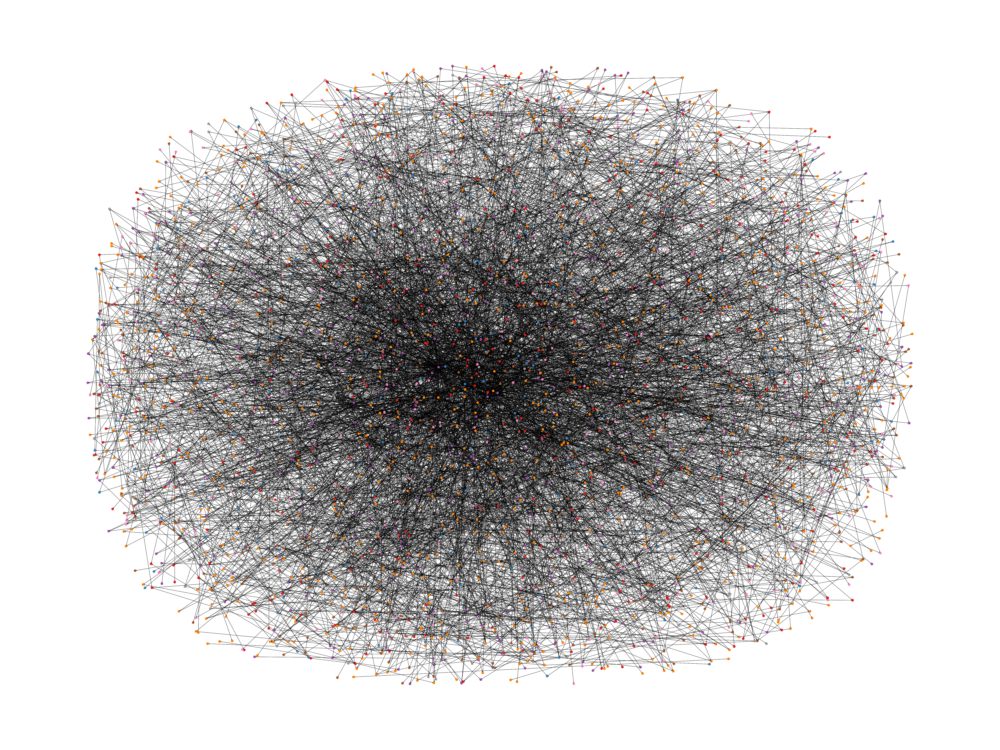

In [ ]:
from torch_geometric.utils.convert import to_networkx

graph = to_networkx(data)
node_labels = data.y[list(graph.nodes)].numpy()

plt.figure(1,figsize=(80,60)) 
pos = nx.spring_layout(graph,k=0.15,iterations=20)
nx.draw(graph, pos=pos, cmap=plt.get_cmap('Set1'), node_color=node_labels, 
        node_size=75, linewidths=6)

plt.savefig('Gnx_Cora.png')
plt.show()

**Pytorch-geometric representation**

The imported Cora graph is an instance of `torch_geometric.data.Data` class. 

A `Data` object holds all information needed to define an arbitrary graph. Such information can be accessed by using attributes and methods of these classes.  

In [ ]:
print(data) 

Data(edge_index=[2, 10556], test_mask=[2708], train_mask=[2708], val_mask=[2708], x=[2708, 1433], y=[2708])


In [ ]:
print("Number of graphs in the dataset: %d" %(len(dataset)))
print("Number of classes: %d" %(dataset.num_classes))
print("Number of features for each node: %d" %(dataset.num_node_features))
print("Number of nodes: %d" %(data.num_nodes))
print("Number of target values: %d" %(len(data.y)))
print("Number of edges: %d" %((data.num_edges)))

print("data.is_undirected() = %s" %(data.is_undirected()))
print("data.contains_isolated_nodes(): %s" %(data.contains_isolated_nodes()))
print("data.contains_self_loops(): %s" %(data.contains_self_loops())) 

Number of graphs in the dataset: 1
Number of classes: 7
Number of features for each node: 1433
Number of nodes: 2708
Number of target values: 2708
Number of edges: 10556
data.is_undirected() = True
data.contains_isolated_nodes(): False
data.contains_self_loops(): False


The splitting into training, validation and test sets is performed introducing the following additional binary attributes to the Data object:

- `data.train_mask` denotes against which nodes to train (140 nodes)
- `data.val_mask` denotes which nodes to use for validation, e.g., to perform early stopping (500 nodes)
- `data.test_mask` denotes against which nodes to test (1000 nodes)

In [ ]:
print("Size of the training set: %s" %(data.train_mask.sum().item()))
print("Size of the validation set: %s" %(data.val_mask.sum().item()))
print("Size of the test set: %s" %(data.test_mask.sum().item()))

print("data.train_mask is a boolean tensor: %s" %(data.train_mask))

Size of the training set: 140
Size of the validation set: 500
Size of the test set: 1000
data.train_mask is a boolean tensor: tensor([ True,  True,  True,  ..., False, False, False])


- `data.x` is a tensor containing a bag of words representation of each paper
- `data.y` is a tensor containing the encoded target values, such that:
  
  0 =  Case_Based

  1 =  Genetic_Algorithms
  
  2 =  Neural_Networks
  
  3 =  Probabilistic_Methods
  
  4 =  Reinforcement_Learning
  
  5 =  Rule_Learning
  
  6 =  Theory

- `data.edge_index` is a tensor in COO format, representing how nodes are connected in the graph



In [ ]:
print("data.x: %s " %(data.x))
print("data.y: %s" %(data.y))
print("data.edge_index: %s" %(data.edge_index))

data.x: tensor([[0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        ...,
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.],
        [0., 0., 0.,  ..., 0., 0., 0.]]) 
data.y: tensor([3, 4, 4,  ..., 3, 3, 3])
data.edge_index: tensor([[   0,    0,    0,  ..., 2707, 2707, 2707],
        [ 633, 1862, 2582,  ...,  598, 1473, 2706]])


Print an example:

In [ ]:
print("%s with ID 1020 has target %s" %(data.x[1020], data.y[1020]))

tensor([0., 0., 0.,  ..., 0., 0., 0.]) with ID 1020 has target tensor(3)


**Add self loops**

Self loops (edges going from each node to itself) are needed to compute attention coefficients.

In [ ]:
from torch_geometric.utils import add_self_loops

print("Before adding self loops: data.contains_self_loops()= %s" 
      %(data.contains_self_loops()))
data.edge_index, _ =add_self_loops(edge_index=data.edge_index)
print("After adding self loops: data.contains_self_loops()= %s" 
      %(data.contains_self_loops()))

Before adding self loops: data.contains_self_loops()= False
After adding self loops: data.contains_self_loops()= True


##Model creation and training

In [ ]:
input_size = dataset.num_node_features
output_size = dataset.num_classes

### Model 1 (GatNet1)

Instanciate an empty model

In [ ]:
model_1 = GatNet1(input_size=input_size, hidden_size=8, output_size=output_size, 
               dropout=0.6, heads_1=8, heads_2=1)
optimizer = torch.optim.Adam(model_1.parameters(), lr=0.005, weight_decay=5e-4)

print(model_1)

params = sum(p.numel() for p in model_1.parameters() if p.requires_grad)
print("Number of trainable parameters: %d" %(params))

GatNet1(
  (Gat1): GatLayer(1433, 8, heads=8)
  (Gat2): GatLayer(64, 7, heads=1)
)
Number of trainable parameters: 92302


Train the model with the dataset



In [ ]:
model_1, indices_1, loss_train_1, acc_train_1, loss_values_1, acc_values_1 = train_early_stop(model_1, data, 
                                                             patience=100, 
                                                             n_epochs=500)

### Model 2 (GatNet1)

Instanciate an empty model

In [ ]:
model_2 = GatNet1(input_size=input_size, hidden_size=12, output_size=output_size, 
               dropout=0.6, heads_1=10, heads_2=3)
optimizer = torch.optim.Adam(model_2.parameters(), lr=0.005, weight_decay=0.005)

print(model_2)

params = sum(p.numel() for p in model_2.parameters() if p.requires_grad)
print("Number of trainable parameters: %d" %(params))

GatNet1(
  (Gat1): GatLayer(1433, 12, heads=10)
  (Gat2): GatLayer(120, 7, heads=3)
)
Number of parameters: 174762
Number of trainable parameters: 174762


Train the model with the dataset

In [ ]:
model_2, indices_2, loss_train_2, acc_train_2, loss_values_2, acc_values_2 = train_early_stop(model_2, data, 
                                                             patience=100, 
                                                             n_epochs=500)

### Model 3 (GatNet2)

Instanciate an empty model

In [ ]:
model_3 = GatNet2(input_size=input_size, hidden1_size=8, hidden2_size=8,
               output_size=output_size, dropout=0.7, heads_1=8, heads_2=8,
               heads_3=4)
optimizer = torch.optim.Adam(model_3.parameters(), lr=0.005, weight_decay=0.01)

print(model_3)

params = sum(p.numel() for p in model_3.parameters() if p.requires_grad)
print("Number of trainable parameters: %d" %(params))

GatNet2(
  (Gat1): GatLayer(1433, 8, heads=8)
  (Gat2): GatLayer(64, 8, heads=8)
  (Gat3): GatLayer(64, 7, heads=4)
)
Number of trainable parameters: 97912


Train the model with the dataset

In [ ]:
model_3, indices_3, loss_train_3, acc_train_3, loss_values_3, acc_values_3 = train_early_stop(model_3, data, 
                                                             patience=100, 
                                                             n_epochs=500)

## Models comparison and evaluation

Plot training histories

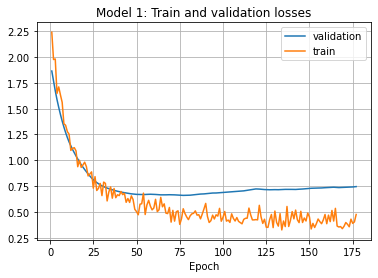

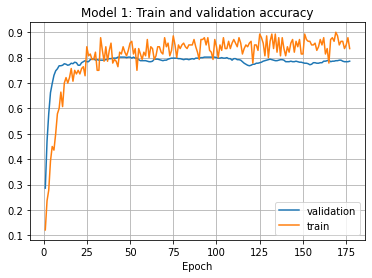

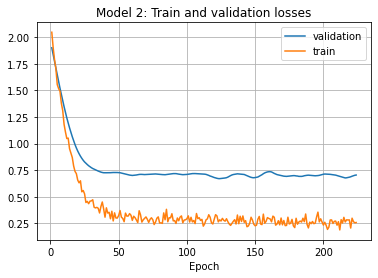

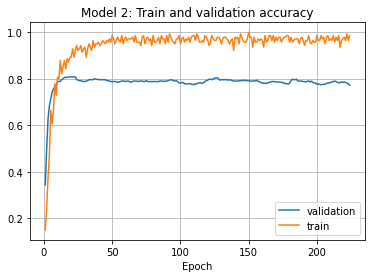

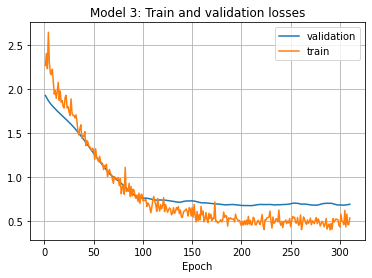

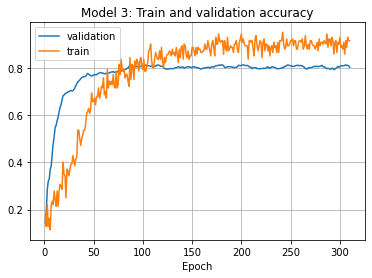

In [ ]:
#model 1
plt.title('Model 1: Train and validation losses')
plot_val_loss_acc(indices_1, loss_values_1, loss_train_1)

plt.title('Model 1: Train and validation accuracy')
plot_val_loss_acc(indices_1, acc_values_1, acc_train_1)

#model 2
plt.title('Model 2: Train and validation losses')
plot_val_loss_acc(indices_2, loss_values_2, loss_train_2)

plt.title('Model 2: Train and validation accuracy')
plot_val_loss_acc(indices_2, acc_values_2, acc_train_2)

#model 3
plt.title('Model 3: Train and validation losses')
plot_val_loss_acc(indices_3, loss_values_3, loss_train_3)

plt.title('Model 3: Train and validation accuracy')
plot_val_loss_acc(indices_3, acc_values_3, acc_train_3)


Validation loss comparison

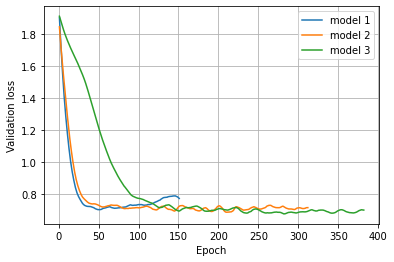

In [ ]:
plt.plot(indices_1, loss_values_1, label='model 1')
plt.plot(indices_2, loss_values_2, label='model 2')
plt.plot(indices_3, loss_values_3, label='model 3')

plt.ylabel('Validation loss')
plt.xlabel('Epoch')
plt.grid(True)
plt.legend()
plt.show()

Validation accuracy comparison

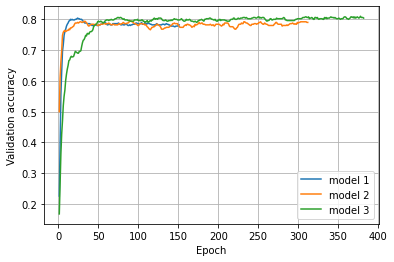

In [ ]:
plt.plot(indices_1, acc_values_1, label='model 1')
plt.plot(indices_2, acc_values_2, label='model 2')
plt.plot(indices_3, acc_values_3, label='model 3')

plt.ylabel('Validation accuracy')
plt.xlabel('Epoch')
plt.grid(True)
plt.legend()
plt.show()

Evaluation on test set

In [ ]:
evaluate(model_1, data, 1)
evaluate(model_2, data, 2)
evaluate(model_3, data, 3)


Accuracy (model 1): 0.7960
Accuracy (model 2): 0.8140
Accuracy (model 3): 0.8020
